In [1]:
import numpy as np 
import pandas as pd
import os
import shutil
import matplotlib.pyplot as plt
from matplotlib.image import imread

#now we sperate the data train and test we can now make a very basic convolution layer using keras to see how it works
import keras

from keras.models import Sequential,Input,Model
from keras.layers import Activation,Dropout,BatchNormalization,Dense,Convolution2D,Flatten
from keras.preprocessing.image import ImageDataGenerator,load_img
import keras.preprocessing.image as im
from keras.preprocessing.image import img_to_array

/home/anupam/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
#lets make the data set
folder_name = "train_data"
categories = os.listdir(folder_name)



if not os.path.isdir(folder_name+"/"+"train"):
    os.makedirs(folder_name+"/"+"train")
if not os.path.isdir(folder_name+"/"+"validation"):
    os.makedirs(folder_name+"/"+"validation")
    


In [3]:
#lets read the images from the folder
image_name = {}
count = 0 
for name in categories:
    
    name_= []
    if not name.endswith('txt'):
        image_name_ =  os.listdir(folder_name+"/"+name)
        myfolder=""
        for each in image_name_:
            file_split  = each.split(".")
            file_name =  name+"."+str(count)+"."+file_split[1]
            
            if not os.path.isdir(folder_name+"/train/"+name):
                myfolder  = folder_name+"/train/"+name
                os.makedirs(myfolder)
            
            shutil.move(folder_name+'/'+name+"/"+each,myfolder+"/"+file_name)
            
            name_.append(myfolder+"/"+file_name)
            count+=1
        
        shutil.rmtree(folder_name+'/'+name)
        
        image_name[name] = name_
            
            
           
        

    

In [4]:
for name in os.listdir(folder_name+"/train/"):
    if not os.path.isdir(folder_name+"/validation/"+name):
        myfolder  = folder_name+"/validation/"+name
        os.makedirs(myfolder)

In [5]:

val_folder = os.listdir(folder_name+"/train/")
for v in val_folder:
    myfiles = os.listdir(folder_name+"/train/"+v)
    if len(myfiles)>50:
        some_files = myfiles[:50]
        for each in some_files:
            shutil.move(folder_name+"/train/"+v+"/"+each,folder_name+"/validation/"+v+"/"+each)

        
        
            
        

In [6]:
#now we sperate the data train and test we can now make a very basic convolution layer using keras to see how it works

# Structure 

model = Sequential()

model.add(Convolution2D(20,(3,3),input_shape=(200,200,3)))
model.add(Activation('relu'))
model.add(Dropout(0.5))

model.add(Convolution2D(20,(3,3)))
model.add(Activation('relu'))
model.add(Dropout(0.5))


model.add(Flatten())
model.add(Dense(80))
model.add(Activation('relu'))
model.add(Dropout(0.5))
model.add(Dense(24))
model.add(Activation('softmax'))



In [7]:

model.compile(loss='categorical_crossentropy',optimizer='Adam',metrics=['accuracy'])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 198, 198, 20)      560       
_________________________________________________________________
activation_1 (Activation)    (None, 198, 198, 20)      0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 198, 198, 20)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 196, 196, 20)      3620      
_________________________________________________________________
activation_2 (Activation)    (None, 196, 196, 20)      0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 196, 196, 20)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 768320)            0         
__________

In [8]:
batch_size = 32

train_datagen = ImageDataGenerator(rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True)

val_data=  ImageDataGenerator(rescale=1./255)


In [9]:
train_data_gen = train_datagen.flow_from_directory(folder_name+"/train/",target_size=(200,200),batch_size=batch_size,class_mode='categorical'
                                                  
                                                  )
val_data_gen =  val_data.flow_from_directory(folder_name+"/validation/",target_size=(200,200),batch_size=batch_size,class_mode='categorical'
                                                 )


Found 4124 images belonging to 24 classes.
Found 650 images belonging to 24 classes.


In [ ]:
model.fit_generator(
        train_data_gen,
        steps_per_epoch=2000// batch_size,
        epochs=20,
        validation_data=val_data_gen,
        validation_steps=800// batch_size )


Epoch 1/20
62/62 [==============================] - 327s 5s/step - loss: 1.6576 - acc: 0.5459 - val_loss: 2.8949 - val_acc: 0.2275
Epoch 2/20
62/62 [==============================] - 323s 5s/step - loss: 1.6018 - acc: 0.5751 - val_loss: 2.5692 - val_acc: 0.2288
Epoch 3/20
62/62 [==============================] - 316s 5s/step - loss: 1.4736 - acc: 0.6079 - val_loss: 2.4923 - val_acc: 0.2802
Epoch 4/20
62/62 [==============================] - 372s 6s/step - loss: 1.4193 - acc: 0.6075 - val_loss: 2.6427 - val_acc: 0.2211
Epoch 5/20
62/62 [==============================] - 271s 4s/step - loss: 1.4727 - acc: 0.5917 - val_loss: 2.4850 - val_acc: 0.2699
Epoch 6/20
62/62 [==============================] - 256s 4s/step - loss: 1.3748 - acc: 0.6149 - val_loss: 2.6939 - val_acc: 0.2354
Epoch 7/20
62/62 [==============================] - 255s 4s/step - loss: 1.3890 - acc: 0.6048 - val_loss: 2.5242 - val_acc: 0.2545
Epoch 8/20
62/62 [==============================] - 255s 4s/step - loss: 1.3059 - a

In [19]:
data  = pd.DataFrame(columns=["ImageName","class"])
count = 0
myDict = {}
with open("test_data/ground_truth.txt","r") as fp:
    for lines in fp:
        result  = lines.split(";")
        result[1] = result[1].replace('\n','')
        myDict[count] = result
        count+=1
    
        


In [20]:
data  = pd.DataFrame(myDict)
data = data.T
data["imageName"] = data[0]
data["class"]     = data[1]

data.drop([0,1],axis=1,inplace=True)
data.head()

,imageName,class
0,20130412_043104_54559.jpg,Snapshot Acqua
1,20130412_043117_54573.jpg,Motobarca
2,20130412_043148_54819.jpg,Vaporetto ACTV
3,20130412_043218_54895.jpg,Mototopo
4,20130412_043335_55056.jpg,Mototopo


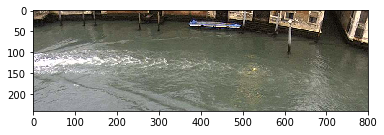

In [21]:
folder =  "test_data/"
myImage  = folder+""+data["imageName"][0]
plt.imshow(imread(myImage))
#lets classify the image

In [22]:
myLabels = os.listdir(folder_name+"/"+"train")


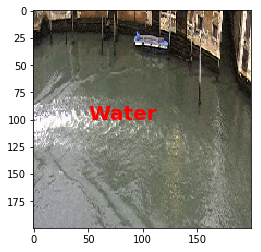

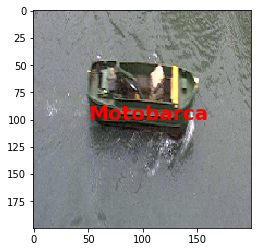

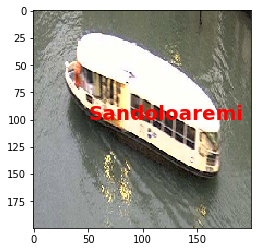

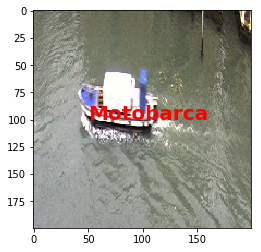

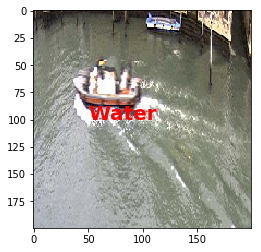

...

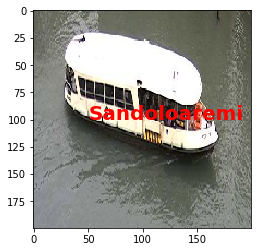

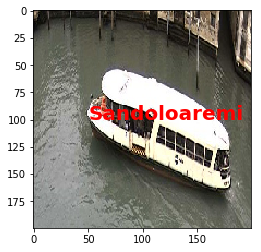

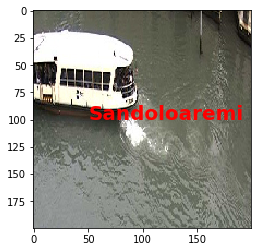

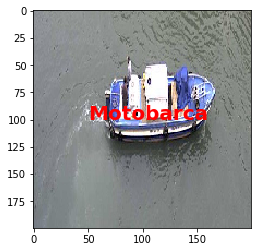

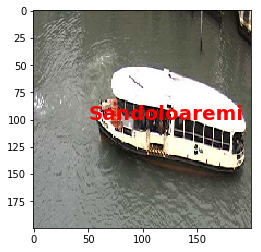

In [ ]:
predict_class = []
for name in  folder+""+data["imageName"]:
    myImage  = load_img(name,target_size=(200,200,3))
    keras_array = img_to_array(myImage)
    expanded_dim = np.expand_dims(keras_array,axis=0)
    predict_class_ = model.predict_classes(expanded_dim)
    name_label  = myLabels[predict_class_[0]]
    predict_class.append(name_label)
    plt.text(50,100,str(name_label),color='red',fontsize=20,weight='bold')
    plt.imshow(myImage)

    plt.show()


In [ ]:
#Basically we have to extract the feature and if we see in the VGG 16 architecture we can say 
# that we only need to skip the last layer which is basically the softmax layer 
# and we only take upto fully connected layer of VGG 16 net work 
# why to use the VGG 
        # Its basically trained in the image net dataset
        # Our task is basically feature extraction 
        
# we read the image and use it as the data set and than use SVM classifier on top of it 

In [24]:
from keras.applications.imagenet_utils  import preprocess_input
input_tensor =  Input(shape=(224,224,3))
model_  = keras.applications.VGG16(input_tensor = input_tensor ,include_top=True,weights='imagenet')
last_layer = model_.get_layer('fc2').output
model_new = Model(input_tensor,last_layer)

In [25]:
def feature_extractor(image_):
    return model_new.predict(image_)


In [26]:
training_data_ = "training_data_feature"

myList  = np.arange(1,4097)

myList = list(myList)
myList.append('class')
data = pd.DataFrame(columns=myList)

In [27]:

testing_data  = "testing_data_feature"
myList  = np.arange(1,4097)

myList = list(myList)
myList.append('class')
x_test = pd.DataFrame(columns=myList)

In [28]:
def extract_feature_training():
    training_data  = {}
    train_data_images = os.listdir(training_data_)
    count  = 0
    for folder_name in train_data_images:
        if not folder_name.endswith("txt"):
            label  = folder_name 

            images  = os.listdir(training_data_+"/"+folder_name)



            for im_  in images:

                if not im_.endswith('txt'):
                    myImage  =  load_img(training_data_+"/"+label+"/"+im_,target_size=(224,224,3))
                    myImage  =  im.img_to_array(myImage)


                    myImage  = np.expand_dims(myImage,axis =  0)

                    myImage  = preprocess_input(myImage)

                    feature_extract  = feature_extractor(myImage) 
                    feature_extract  = list(feature_extract[0])
                    feature_extract.append(label)
                    data.loc[count] =  feature_extract
                    count+=1
    return data

In [29]:
def extract_test_feature():
    count =0
    with open(testing_data+'/ground_truth.txt','r',encoding='utf-8') as fp:
        for lines in fp:
            myImageClass = lines.split(';')
            
            read_image = load_img(testing_data+'/'+myImageClass[0],target_size=(224,224,3))
            read_image = im.img_to_array(read_image)
            read_image = np.expand_dims(read_image,axis=0)
            read_image = preprocess_input(read_image)
            
            feature_extract = feature_extractor(read_image)
            feature_extract = list(feature_extract[0])
            feature_extract.append(myImageClass[1])
            x_test.loc[count] = feature_extract
            count+=1
            if count == 1000:
                break;
            
    return x_test

In [30]:
x_test = extract_test_feature()

In [31]:
x_train = extract_feature_training()

In [32]:
x_test['class'] = list(map(lambda x:x.replace('\n',' ') , x_test['class']))
x_test.head()

,1,2,3,4,5,6,7,8,9,10,...,4088,4089,4090,4091,4092,4093,4094,4095,4096,class
0,0.000000,0.472641,0.000000,0.000000,1.137995,0.0,0.0,0.000000,2.337270,0.0,...,0.000000,0.000000,0.0,0.0,1.066953,2.388787,2.906505,0.266396,0.000000,Snapshot Acqua
1,0.000000,0.000000,1.472176,0.000000,0.000000,0.0,0.0,0.987337,0.726261,0.0,...,0.794018,0.000000,0.0,0.0,0.515087,3.410758,2.935851,0.759109,1.610308,Motobarca
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,2.463849,0.0,...,0.000000,0.000000,0.0,0.0,2.537782,1.727224,4.056146,3.510515,0.000000,Vaporetto ACTV
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.709033,1.231534,0.0,...,0.381049,0.000000,0.0,0.0,1.091876,1.635026,0.000000,1.766343,0.983909,Mototopo
4,1.473692,0.000000,0.000000,0.522268,0.000000,0.0,0.0,0.000000,3.611306,0.0,...,0.000000,1.633073,0.0,0.0,1.356256,0.000000,0.312214,2.655072,0.000000,Mototopo


In [33]:
Y_train = x_train['class']
x_train.drop('class',axis=1,inplace=True)
Y_test  = x_test['class']
x_test.drop('class',axis=1,inplace=True)


print(x_train.shape,Y_train.shape,x_test.shape,Y_test.shape)

(4774, 4096) (4774,) (1000, 4096) (1000,)


In [34]:
#lets take validation data from the training data 
from sklearn.model_selection  import train_test_split

x_train,x_cv,y_train,y_cv = train_test_split(x_train,Y_train,test_size=0.3)
print(x_train.shape,x_cv.shape,y_train.shape,y_cv.shape)

(3341, 4096) (1433, 4096) (3341,) (1433,)


In [35]:
#lets convert the categorical String data into numeric data 
y_train  = y_train.astype('category')
y_train  = y_train.cat.codes

Y_test  = Y_test.astype('category')
y_test  = Y_test.cat.codes

y_cv  = y_cv.astype('category')
y_cv  = y_cv.cat.codes

In [39]:
#lets use some PCA or tsne to reduce the dimension 
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
cs = [0.1, 1, 10,50,70, 100, 1000,2000,3000]
accuracy = []
for c in cs:
    svc = SVC(C = c)
    svc.fit(x_train,y_train)
    y_predicted  = svc.predict(x_cv)
    
    accuracy.append(accuracy_score(y_predicted,y_cv))
    
    print("accuracy for C {} is {}".format(c,accuracy_score(y_predicted,y_cv)))
    

C = cs[accuracy.index(max(accuracy))]

    
svm  =  SVC(C)
svm.fit(x_train,y_train)
print("-----------training accuracy ---------")
y_predict =  svm.predict(x_train)
print("Accuracy For training data  is ",accuracy_score(y_train,y_predict))

print("-----------testing accuracy ---------")
y_predict =  svm.predict(x_test)
print("Accuracy For training data  is ",accuracy_score(Y_test,y_predict))

print("-----------Cv accuracy ---------")
y_predict =  svm.predict(x_cv)
print("Accuracy For training data  is ",accuracy_score(y_cv,y_predict))

accuracy for C 0.1 is 0.0418702023726448
accuracy for C 1 is 0.06559665038381018
accuracy for C 10 is 0.06699232379623168
accuracy for C 50 is 0.06699232379623168
accuracy for C 70 is 0.06699232379623168
accuracy for C 100 is 0.06699232379623168
accuracy for C 1000 is 0.06699232379623168
accuracy for C 2000 is 0.06699232379623168
accuracy for C 3000 is 0.06699232379623168
-----------training accuracy ---------
Accuracy For training data  is  1.0
-----------testing accuracy ---------
Accuracy For training data  is  0.0
-----------Cv accuracy ---------
Accuracy For training data  is  0.06699232379623168


In [48]:
output = len(y_train.value_counts())

In [91]:
#let me train the neural network from the data that we have extracted from the image
from keras.optimizers import Adam
from keras.activations import relu

model_2 = Sequential()

model_2.add(Dense(32,input_shape=([x_train.shape[1]])))
model_2.add(Activation(relu))
model_2.add(Dense(64))
model_2.add(Activation(relu))

model_2.add(Dense(output))
model_2.add(Activation('softmax'))
model_2.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_28 (Dense)             (None, 32)                131104    
_________________________________________________________________
activation_23 (Activation)   (None, 32)                0         
_________________________________________________________________
dense_29 (Dense)             (None, 64)                2112      
_________________________________________________________________
activation_24 (Activation)   (None, 64)                0         
_________________________________________________________________
dense_30 (Dense)             (None, 24)                1560      
_________________________________________________________________
activation_25 (Activation)   (None, 24)                0         
Total params: 134,776
Trainable params: 134,776
Non-trainable params: 0
_________________________________________________________________


In [96]:
model_2.compile(loss='sparse_categorical_crossentropy',optimizer="Adam",metrics=['accuracy'])

In [97]:
model_2.fit(x_train,y_train,batch_size=20,epochs=50,validation_data=(x_cv,y_cv))

Train on 3341 samples, validate on 1433 samples
Epoch 1/50
3341/3341 [==============================] - 3s 771us/step - loss: 1.0582 - acc: 0.7270 - val_loss: 9.7194 - val_acc: 0.0558
Epoch 2/50
3341/3341 [==============================] - 1s 328us/step - loss: 0.5751 - acc: 0.8330 - val_loss: 10.0941 - val_acc: 0.0865
Epoch 3/50
3341/3341 [==============================] - 1s 322us/step - loss: 0.4065 - acc: 0.8854 - val_loss: 10.3045 - val_acc: 0.0691
Epoch 4/50
3341/3341 [==============================] - 1s 337us/step - loss: 0.3158 - acc: 0.9120 - val_loss: 10.0430 - val_acc: 0.0691
Epoch 5/50
3341/3341 [==============================] - 1s 343us/step - loss: 0.2408 - acc: 0.9264 - val_loss: 11.1121 - val_acc: 0.0684
Epoch 6/50
3341/3341 [==============================] - 1s 322us/step - loss: 0.2045 - acc: 0.9353 - val_loss: 11.3747 - val_acc: 0.0621
Epoch 7/50
3341/3341 [==============================] - 1s 324us/step - loss: 0.1648 - acc: 0.9491 - val_loss: 12.0206 - val_acc: 0

In [100]:
model_2.evaluate(x_test,y_test)

1000/1000 [==============================] - 0s 114us/step


[14.122203704833984, 0.039]